<center><h1>DSCI 552 HW6</h1></center>
<br>
<center><font size="4">Tree Based Methods</font></center>
<br />
<table align="center">
    <tbody>
    <tr><td>Name</td><td>Parth Patel</td></tr>
    <tr><td>USC ID</td><td>5228107917</td></tr>
     <tr><td>Github Username</td><td>parthpar-usc</td></tr>
    <tr><td>Email</td><td>parthpar@usc.edu</td></tr>
    </tbody>
</table>

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from seaborn import boxplot as bp
from sklearn.impute import SimpleImputer
from tabulate import tabulate
import math
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.metrics import RocCurveDisplay
from sklearn.metrics import mean_squared_error
from sklearn.metrics import confusion_matrix
import xgboost as xgb
from sklearn.ensemble import RandomForestClassifier
from imblearn.ensemble import BalancedRandomForestClassifier
from imblearn.over_sampling import SMOTE
from imblearn.pipeline import Pipeline as imbpipeline
import warnings
from sklearn.model_selection import GridSearchCV,KFold
from imblearn.over_sampling import SMOTE
from imblearn.pipeline import Pipeline as imbpipeline
import warnings
warnings.filterwarnings("ignore")

## 1. (b) Data Preparation

In [2]:
trainingData = pd.read_csv('../data/aps_failure_training_set.csv', skiprows = 20)
trainingData

,class,aa_000,ab_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,...,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000
0,neg,76698,na,2130706438,280,0,0,0,0,0,...,1240520,493384,721044,469792,339156,157956,73224,0,0,0
1,neg,33058,na,0,na,0,0,0,0,0,...,421400,178064,293306,245416,133654,81140,97576,1500,0,0
2,neg,41040,na,228,100,0,0,0,0,0,...,277378,159812,423992,409564,320746,158022,95128,514,0,0
3,neg,12,0,70,66,0,10,0,0,0,...,240,46,58,44,10,0,0,0,4,32
4,neg,60874,na,1368,458,0,0,0,0,0,...,622012,229790,405298,347188,286954,311560,433954,1218,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59995,neg,153002,na,664,186,0,0,0,0,0,...,998500,566884,1290398,1218244,1019768,717762,898642,28588,0,0
59996,neg,2286,na,2130706538,224,0,0,0,0,0,...,10578,6760,21126,68424,136,0,0,0,0,0
59997,neg,112,0,2130706432,18,0,0,0,0,0,...,792,386,452,144,146,2622,0,0,0,0
59998,neg,80292,na,2130706432,494,0,0,0,0,0,...,699352,222654,347378,225724,194440,165070,802280,388422,0,0


In [3]:
testingData = pd.read_csv('../data/aps_failure_test_set.csv', skiprows = 20)
testingData

,class,aa_000,ab_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,...,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000
0,neg,60,0,20,12,0,0,0,0,0,...,1098,138,412,654,78,88,0,0,0,0
1,neg,82,0,68,40,0,0,0,0,0,...,1068,276,1620,116,86,462,0,0,0,0
2,neg,66002,2,212,112,0,0,0,0,0,...,495076,380368,440134,269556,1315022,153680,516,0,0,0
3,neg,59816,na,1010,936,0,0,0,0,0,...,540820,243270,483302,485332,431376,210074,281662,3232,0,0
4,neg,1814,na,156,140,0,0,0,0,0,...,7646,4144,18466,49782,3176,482,76,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15995,neg,81852,na,2130706432,892,0,0,0,0,0,...,632658,273242,510354,373918,349840,317840,960024,25566,0,0
15996,neg,18,0,52,46,8,26,0,0,0,...,266,44,46,14,2,0,0,0,0,0
15997,neg,79636,na,1670,1518,0,0,0,0,0,...,806832,449962,778826,581558,375498,222866,358934,19548,0,0
15998,neg,110,na,36,32,0,0,0,0,0,...,588,210,180,544,1004,1338,74,0,0,0


In [4]:
pd.set_option('display.max_rows', 5000)
trainingData = trainingData.replace('na', np.NaN)
testingData = testingData.replace('na', np.NaN)
trainingData.isna().sum()

class         0
aa_000        0
ab_000    46329
ac_000     3335
ad_000    14861
ae_000     2500
af_000     2500
ag_000      671
ag_001      671
ag_002      671
ag_003      671
ag_004      671
ag_005      671
ag_006      671
ag_007      671
ag_008      671
ag_009      671
ah_000      645
ai_000      629
aj_000      629
ak_000     4400
al_000      642
am_0        629
an_000      642
ao_000      589
ap_000      642
aq_000      589
ar_000     2723
as_000      629
at_000      629
au_000      629
av_000     2500
ax_000     2501
ay_000      671
ay_001      671
ay_002      671
ay_003      671
ay_004      671
ay_005      671
ay_006      671
ay_007      671
ay_008      671
ay_009      671
az_000      671
az_001      671
az_002      671
az_003      671
az_004      671
az_005      671
az_006      671
az_007      671
az_008      671
az_009      671
ba_000      688
ba_001      688
ba_002      688
ba_003      688
ba_004      688
ba_005      688
ba_006      688
ba_007      688
ba_008      688
ba_009  

In [5]:
testingData.isna().sum()

class         0
aa_000        0
ab_000    12363
ac_000      926
ad_000     3981
ae_000      690
af_000      690
ag_000      189
ag_001      189
ag_002      189
ag_003      189
ag_004      189
ag_005      189
ag_006      189
ag_007      189
ag_008      189
ag_009      189
ah_000      175
ai_000      163
aj_000      163
ak_000     1198
al_000      169
am_0        163
an_000      169
ao_000      162
ap_000      169
aq_000      162
ar_000      764
as_000      163
at_000      163
au_000      163
av_000      688
ax_000      688
ay_000      192
ay_001      192
ay_002      192
ay_003      192
ay_004      192
ay_005      192
ay_006      192
ay_007      192
ay_008      192
ay_009      192
az_000      192
az_001      192
az_002      192
az_003      192
az_004      192
az_005      192
az_006      192
az_007      192
az_008      192
az_009      192
ba_000      193
ba_001      193
ba_002      193
ba_003      193
ba_004      193
ba_005      193
ba_006      193
ba_007      193
ba_008      193
ba_009  

## (b) i. Techniques to deal with missing values
i. We can use statistics such as mean, median and mode to replace the missing values.

ii. We can replace the missing values with the corresponding value in a randomly selected observation from the dataset.

iii. We can use iterative methods that are based on Expectation Maximization to handle the missing values.

## For this assignment, we will use the mean value of the columns to fill in the missing values in the corresponding column.

In [6]:
data = pd.concat([trainingData, testingData], ignore_index = True)
data

,class,aa_000,ab_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,...,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000
0,neg,76698,NaN,2130706438,280,0,0,0,0,0,...,1240520,493384,721044,469792,339156,157956,73224,0,0,0
1,neg,33058,NaN,0,NaN,0,0,0,0,0,...,421400,178064,293306,245416,133654,81140,97576,1500,0,0
2,neg,41040,NaN,228,100,0,0,0,0,0,...,277378,159812,423992,409564,320746,158022,95128,514,0,0
3,neg,12,0,70,66,0,10,0,0,0,...,240,46,58,44,10,0,0,0,4,32
4,neg,60874,NaN,1368,458,0,0,0,0,0,...,622012,229790,405298,347188,286954,311560,433954,1218,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75995,neg,81852,NaN,2130706432,892,0,0,0,0,0,...,632658,273242,510354,373918,349840,317840,960024,25566,0,0
75996,neg,18,0,52,46,8,26,0,0,0,...,266,44,46,14,2,0,0,0,0,0
75997,neg,79636,NaN,1670,1518,0,0,0,0,0,...,806832,449962,778826,581558,375498,222866,358934,19548,0,0
75998,neg,110,NaN,36,32,0,0,0,0,0,...,588,210,180,544,1004,1338,74,0,0,0


In [7]:
xData = data.drop(columns = ['class'])
xData

,aa_000,ab_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,ag_003,...,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000
0,76698,NaN,2130706438,280,0,0,0,0,0,0,...,1240520,493384,721044,469792,339156,157956,73224,0,0,0
1,33058,NaN,0,NaN,0,0,0,0,0,0,...,421400,178064,293306,245416,133654,81140,97576,1500,0,0
2,41040,NaN,228,100,0,0,0,0,0,0,...,277378,159812,423992,409564,320746,158022,95128,514,0,0
3,12,0,70,66,0,10,0,0,0,318,...,240,46,58,44,10,0,0,0,4,32
4,60874,NaN,1368,458,0,0,0,0,0,0,...,622012,229790,405298,347188,286954,311560,433954,1218,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75995,81852,NaN,2130706432,892,0,0,0,0,0,0,...,632658,273242,510354,373918,349840,317840,960024,25566,0,0
75996,18,0,52,46,8,26,0,0,0,0,...,266,44,46,14,2,0,0,0,0,0
75997,79636,NaN,1670,1518,0,0,0,0,0,0,...,806832,449962,778826,581558,375498,222866,358934,19548,0,0
75998,110,NaN,36,32,0,0,0,0,0,0,...,588,210,180,544,1004,1338,74,0,0,0


In [8]:
simpleImputer = SimpleImputer(strategy = 'mean', missing_values = np.NaN)
simpleImputer = simpleImputer.fit(xData)
xData.iloc[:, :] = simpleImputer.transform(xData)
xData

,aa_000,ab_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,ag_003,...,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000
0,76698,0.72556,2130706438.0,280.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1240520.0,493384.0,721044.0,469792.0,339156.0,157956.0,73224.0,0.0,0.0,0.0
1,33058,0.72556,0.0,150629.962105,0.0,0.0,0.0,0.0,0.0,0.0,...,421400.0,178064.0,293306.0,245416.0,133654.0,81140.0,97576.0,1500.0,0.0,0.0
2,41040,0.72556,228.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,...,277378.0,159812.0,423992.0,409564.0,320746.0,158022.0,95128.0,514.0,0.0,0.0
3,12,0.0,70.0,66.0,0.0,10.0,0.0,0.0,0.0,318.0,...,240.0,46.0,58.0,44.0,10.0,0.0,0.0,0.0,4.0,32.0
4,60874,0.72556,1368.0,458.0,0.0,0.0,0.0,0.0,0.0,0.0,...,622012.0,229790.0,405298.0,347188.0,286954.0,311560.0,433954.0,1218.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75995,81852,0.72556,2130706432.0,892.0,0.0,0.0,0.0,0.0,0.0,0.0,...,632658.0,273242.0,510354.0,373918.0,349840.0,317840.0,960024.0,25566.0,0.0,0.0
75996,18,0.0,52.0,46.0,8.0,26.0,0.0,0.0,0.0,0.0,...,266.0,44.0,46.0,14.0,2.0,0.0,0.0,0.0,0.0,0.0
75997,79636,0.72556,1670.0,1518.0,0.0,0.0,0.0,0.0,0.0,0.0,...,806832.0,449962.0,778826.0,581558.0,375498.0,222866.0,358934.0,19548.0,0.0,0.0
75998,110,0.72556,36.0,32.0,0.0,0.0,0.0,0.0,0.0,0.0,...,588.0,210.0,180.0,544.0,1004.0,1338.0,74.0,0.0,0.0,0.0


In [9]:
yData = data['class']
yData

0        neg
1        neg
2        neg
3        neg
4        neg
        ... 
75995    neg
75996    neg
75997    neg
75998    neg
75999    neg
Name: class, Length: 76000, dtype: object

In [10]:
yData = yData.map({'pos': 1, 'neg': 0})
yData

0        0
1        0
2        0
3        0
4        0
        ..
75995    0
75996    0
75997    0
75998    0
75999    0
Name: class, Length: 76000, dtype: int64

In [11]:
xTrain = xData.iloc[:60000, :]
xTest = xData.iloc[60000:, :]
yTrain = yData.iloc[:60000]
yTest = yData.iloc[60000:]

print(xTrain, xTest, yTrain, yTest)

       aa_000   ab_000        ac_000         ad_000 ae_000 af_000 ag_000  \
0       76698  0.72556  2130706438.0          280.0    0.0    0.0    0.0   
1       33058  0.72556           0.0  150629.962105    0.0    0.0    0.0   
2       41040  0.72556         228.0          100.0    0.0    0.0    0.0   
3          12      0.0          70.0           66.0    0.0   10.0    0.0   
4       60874  0.72556        1368.0          458.0    0.0    0.0    0.0   
...       ...      ...           ...            ...    ...    ...    ...   
59995  153002  0.72556         664.0          186.0    0.0    0.0    0.0   
59996    2286  0.72556  2130706538.0          224.0    0.0    0.0    0.0   
59997     112      0.0  2130706432.0           18.0    0.0    0.0    0.0   
59998   80292  0.72556  2130706432.0          494.0    0.0    0.0    0.0   
59999   40222  0.72556         698.0          628.0    0.0    0.0    0.0   

      ag_001 ag_002  ag_003  ...     ee_002    ee_003     ee_004     ee_005  \
0       

# ii. Coefficient of variation for the features

In [12]:
features = xData.columns
features

Index(['aa_000', 'ab_000', 'ac_000', 'ad_000', 'ae_000', 'af_000', 'ag_000',
       'ag_001', 'ag_002', 'ag_003',
       ...
       'ee_002', 'ee_003', 'ee_004', 'ee_005', 'ee_006', 'ee_007', 'ee_008',
       'ee_009', 'ef_000', 'eg_000'],
      dtype='object', length=170)

In [13]:
coefficients = []
for f in features:
    d = xData[f]
    std = d.std()
    mean = d.mean()
    coeff = round(std / mean, 3)
    coefficients.append([f, coeff])

print(tabulate(coefficients, headers = ['Features', 'Coefficient of Variation(CV)']))

Features      Coefficient of Variation(CV)
----------  ------------------------------
aa_000                               4.329
ab_000                               2.178
ac_000                               2.168
ad_000                             206.721
ae_000                              22.294
af_000                              18.209
ag_000                              91.461
ag_001                              42.084
ag_002                              17.626
ag_003                               8.753
ag_004                               5.475
ag_005                               2.964
ag_006                               2.353
ag_007                               2.812
ag_008                               6.275
ag_009                              32.167
ah_000                               2.316
ai_000                              18.506
aj_000                              43.144
ak_000                              78.623
al_000                               9.112
am_0       

## iii. Correlation Matrix

In [14]:
corMat = xData.corr()
corMat.style.background_gradient(cmap = 'PuBu')

## iv. Scatterplots and Boxplots

In [15]:
coefficients.sort(key = lambda c: c[1], reverse = True)
coefficients

[['cf_000', 207.27],
 ['co_000', 206.876],
 ['ad_000', 206.721],
 ['cs_009', 192.523],
 ['dj_000', 122.128],
 ['as_000', 113.883],
 ['dh_000', 112.652],
 ['df_000', 111.37],
 ['ag_000', 91.461],
 ['au_000', 86.086],
 ['ak_000', 78.623],
 ['az_009', 78.0],
 ['ay_009', 77.461],
 ['ch_000', 57.498],
 ['cs_008', 57.202],
 ['ay_001', 49.249],
 ['dz_000', 49.249],
 ['ef_000', 47.92],
 ['eg_000', 45.651],
 ['aj_000', 43.144],
 ['ag_001', 42.084],
 ['ay_000', 40.903],
 ['ay_002', 38.342],
 ['dl_000', 37.457],
 ['dk_000', 36.518],
 ['dg_000', 34.677],
 ['dm_000', 34.552],
 ['ay_004', 33.04],
 ['ea_000', 32.777],
 ['ag_009', 32.167],
 ['cn_009', 30.961],
 ['ay_003', 28.33],
 ['cy_000', 28.006],
 ['cn_000', 27.975],
 ['da_000', 25.206],
 ['at_000', 23.187],
 ['az_008', 22.415],
 ['ae_000', 22.294],
 ['dq_000', 21.185],
 ['ai_000', 18.506],
 ['af_000', 18.209],
 ['ag_002', 17.626],
 ['az_007', 15.382],
 ['cp_000', 12.919],
 ['cn_001', 12.625],
 ['cr_000', 12.471],
 ['cl_000', 12.164],
 ['az_002', 

In [16]:
requiredFeatures = []
for i in range(int(math.sqrt(170))):
    requiredFeatures.append(coefficients[i][0])
requiredFeatures

['cf_000',
 'co_000',
 'ad_000',
 'cs_009',
 'dj_000',
 'as_000',
 'dh_000',
 'df_000',
 'ag_000',
 'au_000',
 'ak_000',
 'az_009',
 'ay_009']

In [17]:
requiredXData = xData[requiredFeatures]
requiredData = pd.concat([requiredXData, yData], axis = 1)
requiredData

,cf_000,co_000,ad_000,cs_009,dj_000,as_000,dh_000,df_000,ag_000,au_000,ak_000,az_009,ay_009,class
0,2.0,220.0,280.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
1,150231.156793,150517.375485,150629.962105,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
2,0.0,0.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
3,2.0,2.0,66.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
4,0.0,202.0,458.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75995,2.0,42.0,892.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
75996,2.0,0.0,46.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
75997,2.0,378.0,1518.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
75998,0.0,0.0,32.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0


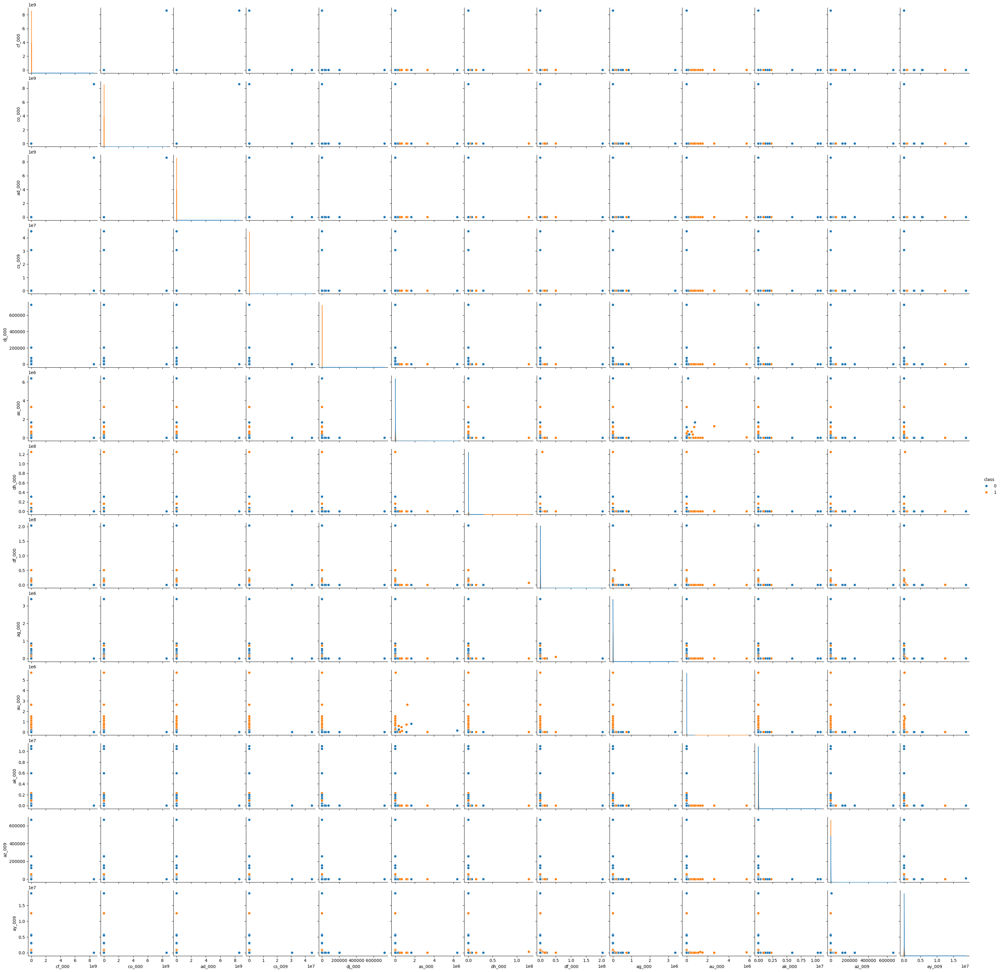

In [18]:
sns.pairplot(requiredData, hue = 'class')

## From the pairplot, we can see that the two classes are seperable for some pairs of features.

{'whiskers': [<matplotlib.lines.Line2D at 0x2f1d518b0>,
 'caps': [<matplotlib.lines.Line2D at 0x2f1d39c70>,
 'boxes': [<matplotlib.lines.Line2D at 0x2ea9cf6d0>,
 'medians': [<matplotlib.lines.Line2D at 0x2f1d735e0>,
 'fliers': [<matplotlib.lines.Line2D at 0x2f1d731f0>,
 'means': []}

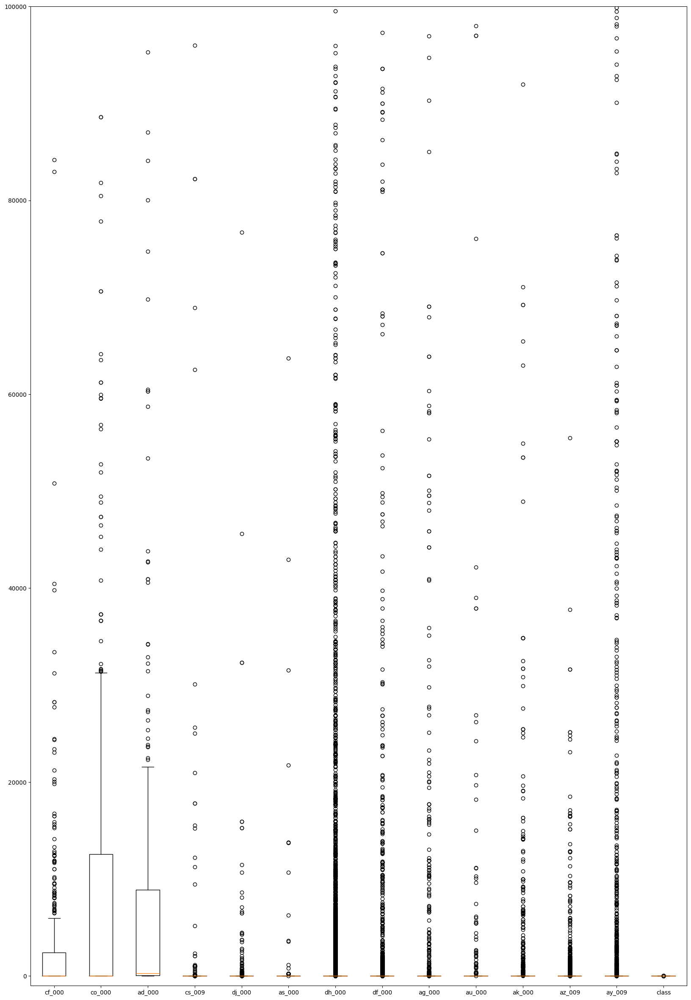

In [19]:
fig, axs = plt.subplots(figsize=(20, 30))
axs.set_ylim(-1000,100000)
axs.set_xticklabels(list(requiredData.columns))
axs.boxplot(requiredData)

## v. Number of negatives and positives and presence of class imbalance?

In [20]:
data['class'].value_counts()

class
neg    74625
pos     1375
Name: count, dtype: int64

 From the numbers seen above, we can clearly say that the number of negative class samples is greater than the positive class samples. Hence, we can say that the data is highly imbalanced.

## (c) Random Forest

In [21]:
randomForestModel = RandomForestClassifier(oob_score = True)
randomForestModel = randomForestModel.fit(xTrain, yTrain)
yPredicted = randomForestModel.predict(xTest)
accuracy = accuracy_score(yTest, yPredicted)
print('The accuracy for the random forest model on test is', accuracy)

The accuracy for the random forest model on test is 0.992


In [22]:
error = round(1 - accuracy, 3)
print('The test error is', error)

The test error is 0.008


In [23]:
oobError = round(1 - randomForestModel.oob_score_, 3)
print('The Out Of Bag error is', oobError)

The Out Of Bag error is 0.006


In [24]:
confMatrixTest = confusion_matrix(yTest, yPredicted)
trueNegative, falsePositive, falseNegative, testPositive = confMatrixTest.ravel()
print('The confusion matrix is\n', confMatrixTest)

The confusion matrix is
 [[15606    19]
 [  109   266]]


In [25]:
print('Misclassified test data samples are', falsePositive + falseNegative)

Misclassified test data samples are 128


In [26]:
yPredictedTraining = randomForestModel.predict(xTrain)
trainAccuracy = accuracy_score(yTrain, yPredictedTraining)
print('The accuracy for the random forest model on train is', trainAccuracy)

The accuracy for the random forest model on train is 1.0


In [27]:
confMatrixTrain = confusion_matrix(yTrain, yPredictedTraining)
trueNegativeTrain, falsePositiveTrain, falseNegativeTrain, testPositiveTrain = confMatrixTrain.ravel()
print('The confusion matrix is\n', confMatrixTrain)

The confusion matrix is
 [[59000     0]
 [    0  1000]]


In [28]:
print('Misclassified train data samples are', falsePositiveTrain + falseNegativeTrain)

Misclassified train data samples are 0


AUC value for test data is 0.854


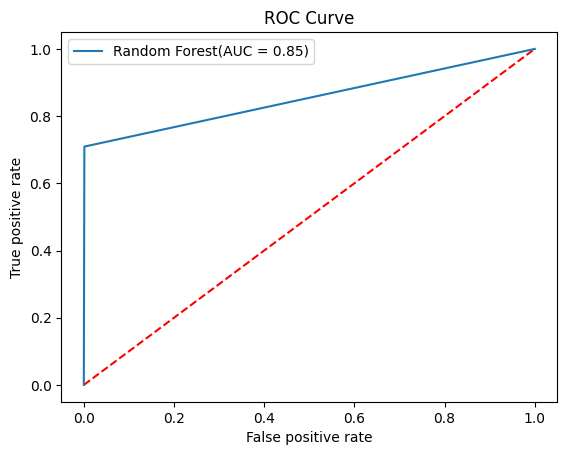

In [29]:
testFPR, testTPR, testThreshold = roc_curve(yTest, yPredicted)
testAuc = round(roc_auc_score(yTest, yPredicted), 3)
plt.plot([0, 1], [0, 1], 'r--')
plt.plot(testFPR, testTPR, label = 'Random Forest(AUC = %0.2f)'%testAuc)
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC Curve')
plt.legend()
print('AUC value for test data is', testAuc)

AUC value for train data is 1.0


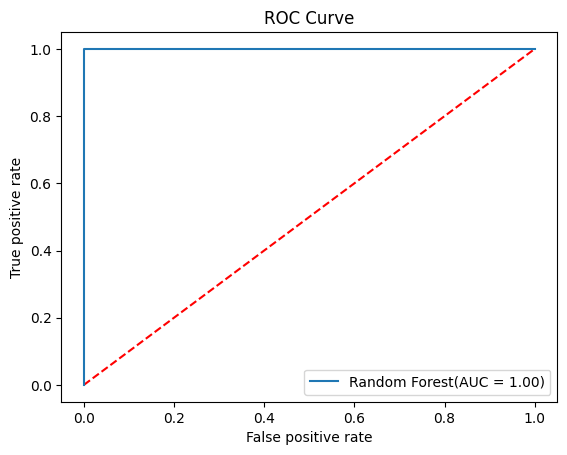

In [30]:
trainFPR, trainTPR, trainThreshold = roc_curve(yTrain, yPredictedTraining)
trainAuc = round(roc_auc_score(yTrain, yPredictedTraining), 3)
plt.plot([0, 1], [0, 1], 'r--')
plt.plot(trainFPR, trainTPR, label = 'Random Forest(AUC = %0.2f)'%trainAuc)
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC Curve')
plt.legend()
print('AUC value for train data is', trainAuc)

## (d) Research class imbalance in random forests

# The two ways of handling class imbalance in case of random forests are as follows:

Using a balanced random forest classifier.

Using class_weights as balanced.

In [31]:
randomForestClassifierBalanced = RandomForestClassifier(oob_score = True, class_weight = 'balanced')
randomForestClassifierBalanced = randomForestClassifierBalanced.fit(xTrain, yTrain)


yPredicted = randomForestClassifierBalanced.predict(xTest)
accuracyTest = accuracy_score(yTest, yPredicted)

errorTestBalanced = round(1 - accuracyTest, 3)
print("The test error for balanced random forest is", errorTestBalanced)

oobErrorBalanced = round(1 - randomForestClassifierBalanced.oob_score_, 3)
print("The Out Of Bag error for balanced random forest is", oobErrorBalanced)

confMatrixTest = confusion_matrix(yTest, yPredicted)
trueNegativeTest, falsePositiveTest, falseNegativeTest, truePositiveTest = confMatrixTest.ravel()
print("Confusion matrix for test is", confMatrixTest)
print("The test missclassification is", falsePositiveTest + falseNegativeTest)

yPredictedTrain = randomForestClassifierBalanced.predict(xTrain)
accuracyTrain = accuracy_score(yTrain, yPredictedTrain)
errorTrainBalanced = round(1 - accuracyTrain, 3)
print("The train error for balanced random forest is", errorTrainBalanced)

confMatrixTrain = confusion_matrix(yTrain, yPredictedTrain)
trueNegativeTrain, falsePositiveTrain, falseNegativeTrain, truePositiveTrain = confMatrixTrain.ravel()
print("Confusion matrix for train is", confMatrixTrain)
print("The test missclassification is", falsePositiveTrain + falseNegativeTrain)


The test error for balanced random forest is 0.011
The Out Of Bag error for balanced random forest is 0.008
Confusion matrix for test is [[15613    12]
 [  162   213]]
The test missclassification is 174
The train error for balanced random forest is 0.0
Confusion matrix for train is [[59000     0]
 [    0  1000]]
The test missclassification is 0


AUC value for test data is 0.784


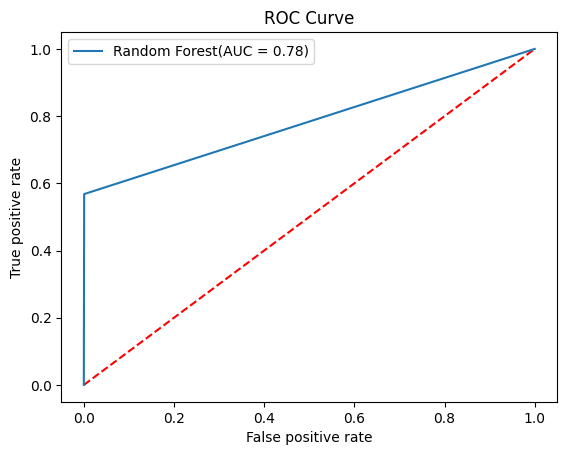

In [32]:
testFPR, testTPR, testThreshold = roc_curve(yTest, yPredicted)
testAuc = round(roc_auc_score(yTest, yPredicted), 3)
plt.plot([0, 1], [0, 1], 'r--')
plt.plot(testFPR, testTPR, label = 'Random Forest(AUC = %0.2f)'%testAuc)
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC Curve')
plt.legend()
print('AUC value for test data is', testAuc)

AUC value for train data is 1.0


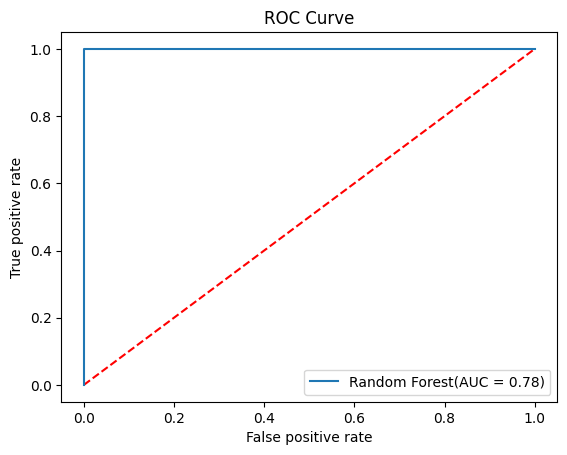

In [33]:
trainFPR, trainTPR, trainThreshold = roc_curve(yTrain, yPredictedTrain)
trainAuc = round(roc_auc_score(yTrain, yPredictedTrain), 3)
plt.plot([0, 1], [0, 1], 'r--')
plt.plot(trainFPR, trainTPR, label = 'Random Forest(AUC = %0.2f)'%testAuc)
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC Curve')
plt.legend()
print('AUC value for train data is', trainAuc)

In [34]:
l = [[error, errorTestBalanced, oobError, oobErrorBalanced]]
print(tabulate(l, headers = ['Test Error(RF)', 'Test Error(Balanced RF)', 'OOB Error(RF)', 'OOB Error(Balanced RF)']))

  Test Error(RF)    Test Error(Balanced RF)    OOB Error(RF)    OOB Error(Balanced RF)
----------------  -------------------------  ---------------  ------------------------
           0.008                      0.011            0.006                     0.008


## (e) XG Boost

In [35]:
alphas = [1e-4, 1e-3, 1e-2, 1e-1, 1, 1e+1, 1e+2, 1e+3, 1e+4]
xTrain = xTrain.astype(float)
yTrain = yTrain.astype(float)
xgBoostModel = xgb.XGBClassifier(objective = 'binary:logistic', use_label_encoder = False, eval_metric = 'logloss')
xgbParameters = {'reg_alpha': alphas}

xgbModelVal = GridSearchCV(xgBoostModel, xgbParameters, cv = 5)
xgbModelVal = xgbModelVal.fit(xTrain, yTrain)

bestAlpha = xgbModelVal.best_params_['reg_alpha']
bestAlpha = round(bestAlpha, 6)

print('Best alpha is', bestAlpha)

Best alpha is 0.0001


In [36]:
xgbModel = xgb.XGBClassifier(objective = "binary:logistic", use_label_encoder = False, eval_metric = 'logloss', reg_alpha = bestAlpha)
xgbModel = xgbModel.fit(xTrain, yTrain)
xTest = xTest.astype(float)
yPredicted = xgbModel.predict(xTest)
xgbMSE = round(mean_squared_error(yTest, yPredicted), 3)
print('The test MSE for XGBoost Regression is', xgbMSE)

The test MSE for XGBoost Regression is 0.006


In [37]:
error = 1 - accuracy_score(yTest, yPredicted)
print('The test error is', error)

The test error is 0.0061875000000000124


In [38]:
confMatrixTest = confusion_matrix(yTest, yPredicted)
trueNegativeTest, falsePositiveTest, falseNegativeTest, truePositiveTest = confMatrixTest.ravel()
print("Confusion matrix for test is", confMatrixTest)

Confusion matrix for test is [[15606    19]
 [   80   295]]


In [39]:
yPredictedTrain = xgbModel.predict(xTrain)
error = 1 - accuracy_score(yTrain, yPredictedTrain)
print('The train error is', error)

The train error is 1.666666666666483e-05


In [40]:
confMatrixTrain = confusion_matrix(yTrain, yPredictedTrain)
trueNegativeTrain, falsePositiveTrain, falseNegativeTrain, truePositiveTrain = confMatrixTrain.ravel()
print("Confusion matrix for train is", confMatrixTrain)

Confusion matrix for train is [[59000     0]
 [    1   999]]


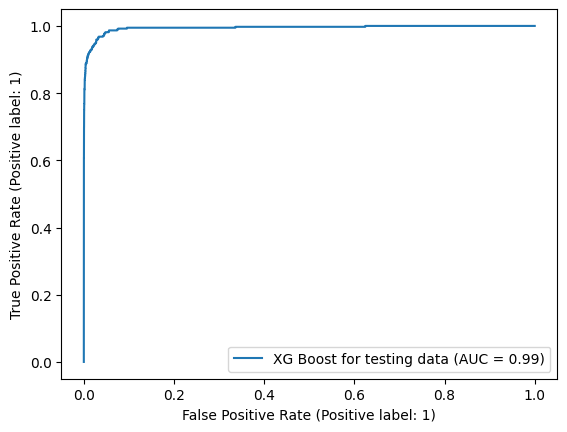

In [41]:
RocCurveDisplay.from_estimator(xgbModel, xTest, yTest, name = 'XG Boost for testing data')


AUC value for train data is 1.0


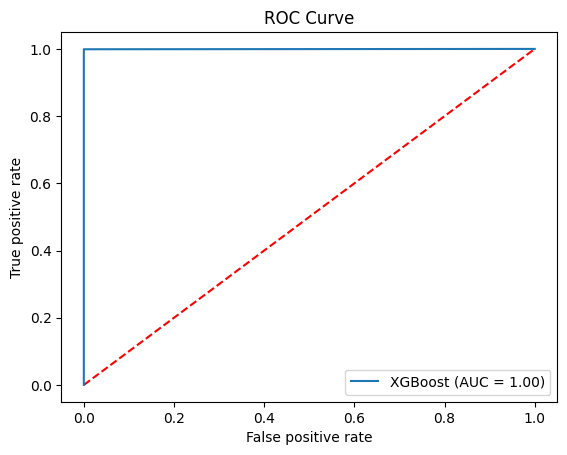

In [42]:
trainFPR, trainTPR, trainThreshold = roc_curve(yTrain, yPredictedTrain)
trainAuc = round(roc_auc_score(yTrain, yPredictedTrain), 3)
plt.plot([0, 1], [0, 1], 'r--')
plt.plot(trainFPR, trainTPR, label = 'XGBoost (AUC = %0.2f)'%trainAuc)
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC Curve')
plt.legend()
print('AUC value for train data is', trainAuc)

## (f) SMOTE with XGB

In [43]:
pipeline = imbpipeline(steps = [['smote', SMOTE(random_state = 11)], ['classifier', xgb.XGBClassifier(objective = "binary:logistic", use_label_encoder = False, eval_metric = 'logloss')]])
paramGrid = {'classifier__reg_alpha': [1e-4, 1e-3, 1e-2, 1e-1, 1, 1e+1, 1e+2, 1e+3, 1e+4]}
xgbSmoteModel = GridSearchCV(estimator = pipeline, param_grid = paramGrid, cv = 5)
xgbSmoteModel = xgbSmoteModel.fit(xTrain, yTrain)

bestAlpha = round(xgbSmoteModel.best_params_['classifier__reg_alpha'], 3)
print("The best alpha is", bestAlpha)

The best alpha is 0.1


In [44]:
smote = SMOTE(random_state = 36)
xRes, yRes = smote.fit_resample(xTrain, yTrain)

In [45]:
xgbSmoteModel = xgb.XGBClassifier(objective = "binary:logistic", use_label_encoder = False, eval_metric = 'logloss', reg_alpha = bestAlpha)
xgbSmoteModel = xgbSmoteModel.fit(xRes, yRes)
yPredicted = xgbSmoteModel.predict(xTest)
xgboostMSE = round(mean_squared_error(yTest, yPredicted),5)
print('Test MSE for XGBoost regression is', xgboostMSE)

Test MSE for XGBoost regression is 0.00719


In [46]:
confMatrixTest = confusion_matrix(yTest, yPredicted)
trueNegativeTest, falsePositiveTest, falseNegativeTest, truePositiveTest = confMatrixTest.ravel()
print("Confusion matrix for test is", confMatrixTest)

Confusion matrix for test is [[15576    49]
 [   66   309]]


In [47]:
yPredictedTrain = xgbSmoteModel.predict(xTrain)
error = 1 - accuracy_score(yTrain, yPredictedTrain)
print('The train error is', error)
confMatrixTrain = confusion_matrix(yTrain, yPredictedTrain)
trueNegativeTrain, falsePositiveTrain, falseNegativeTrain, truePositiveTrain = confMatrixTrain.ravel()
print("Confusion matrix for train is", confMatrixTrain)

The train error is 1.666666666666483e-05
Confusion matrix for train is [[59000     0]
 [    1   999]]


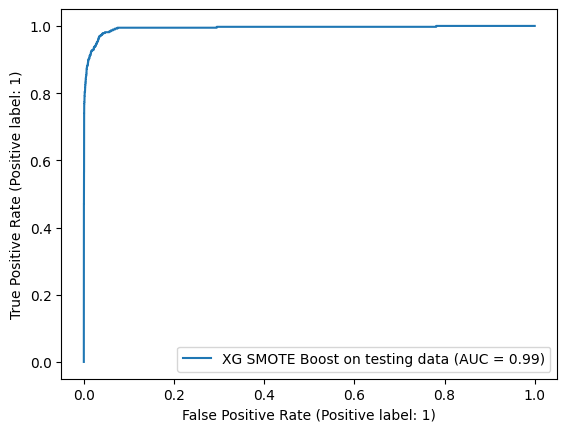

In [48]:
RocCurveDisplay.from_estimator(xgbSmoteModel, xTest, yTest, name = 'XG SMOTE Boost on testing data')

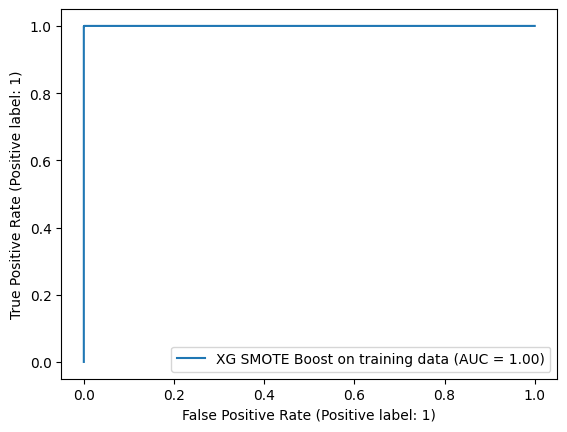

In [49]:
RocCurveDisplay.from_estimator(xgbSmoteModel, xTrain, yTrain, name = 'XG SMOTE Boost on training data')

After using SMOTE our test error has increased sligthly from 0.006 to 0.007 but that is acceptable as we are adding more data to increase the number of positive class samples to handle the class imbalance. This classifier is a better predictor as it is getting trained on more balanced class data.

## ISLR 6.6.3


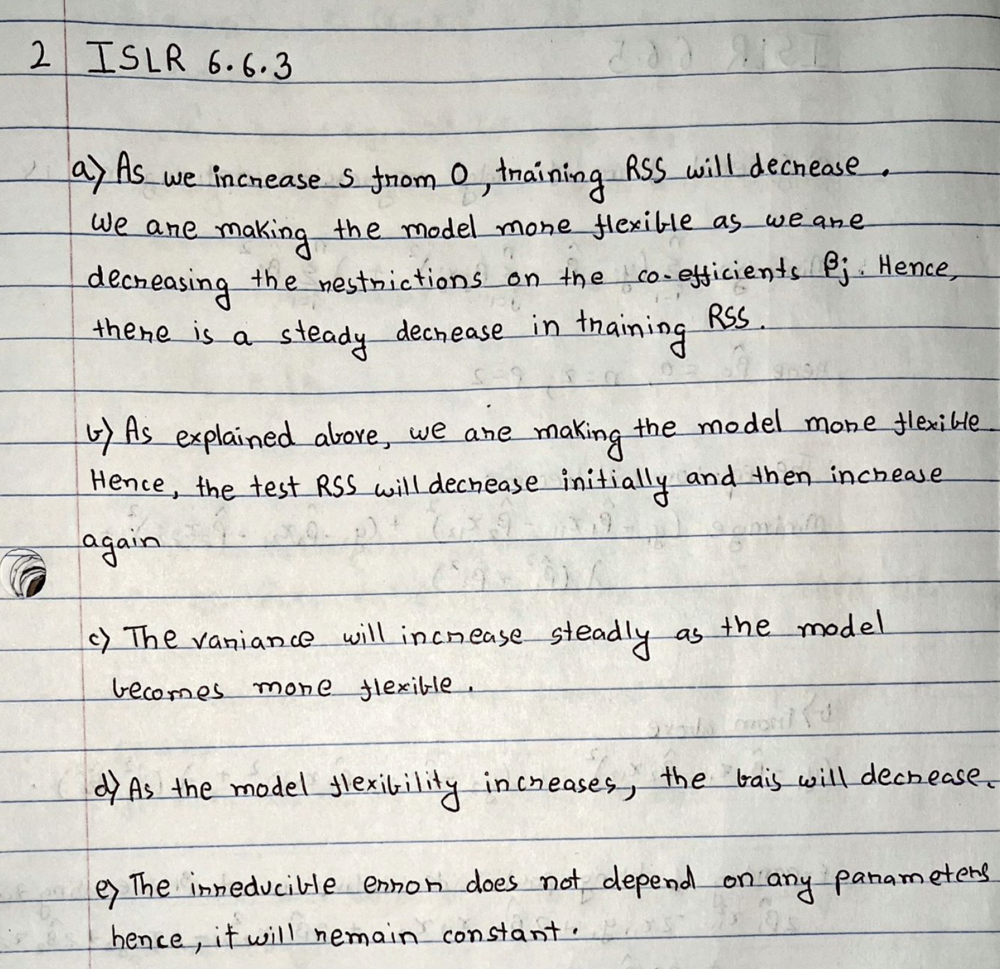

In [50]:
from IPython.display import Image
Image(filename='ISLR6.6.3.png')

## ISLR 6.6.5

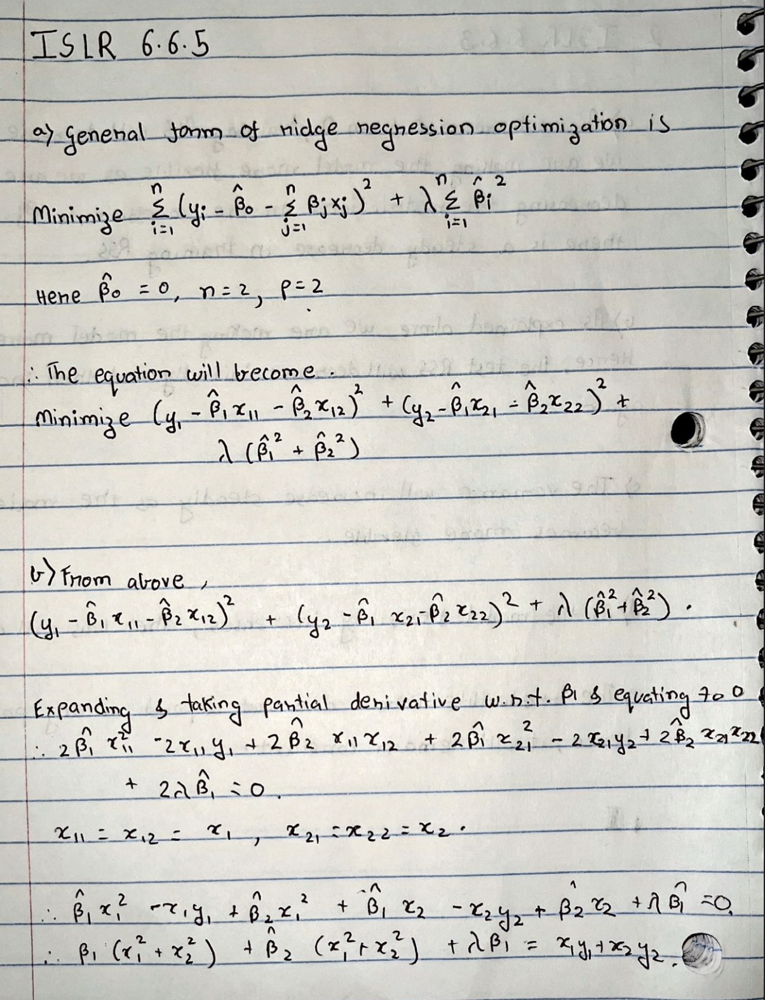

In [52]:
from IPython.display import Image
Image(filename='ISLR6.6.5.1.png')

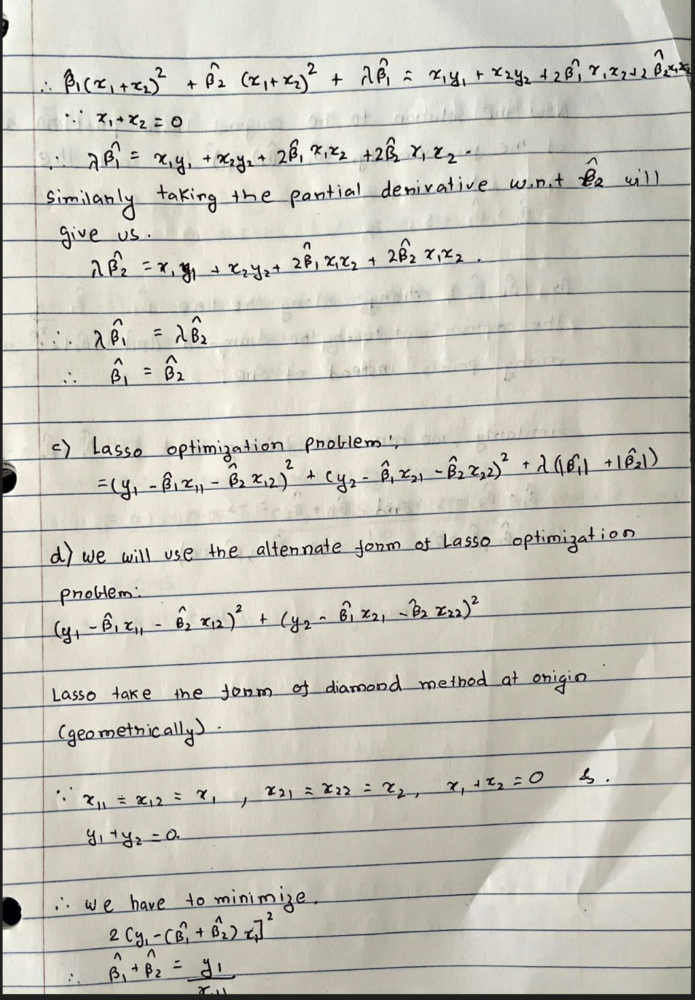

In [54]:
from IPython.display import Image
Image(filename='ISLR6.6.5.2.png')

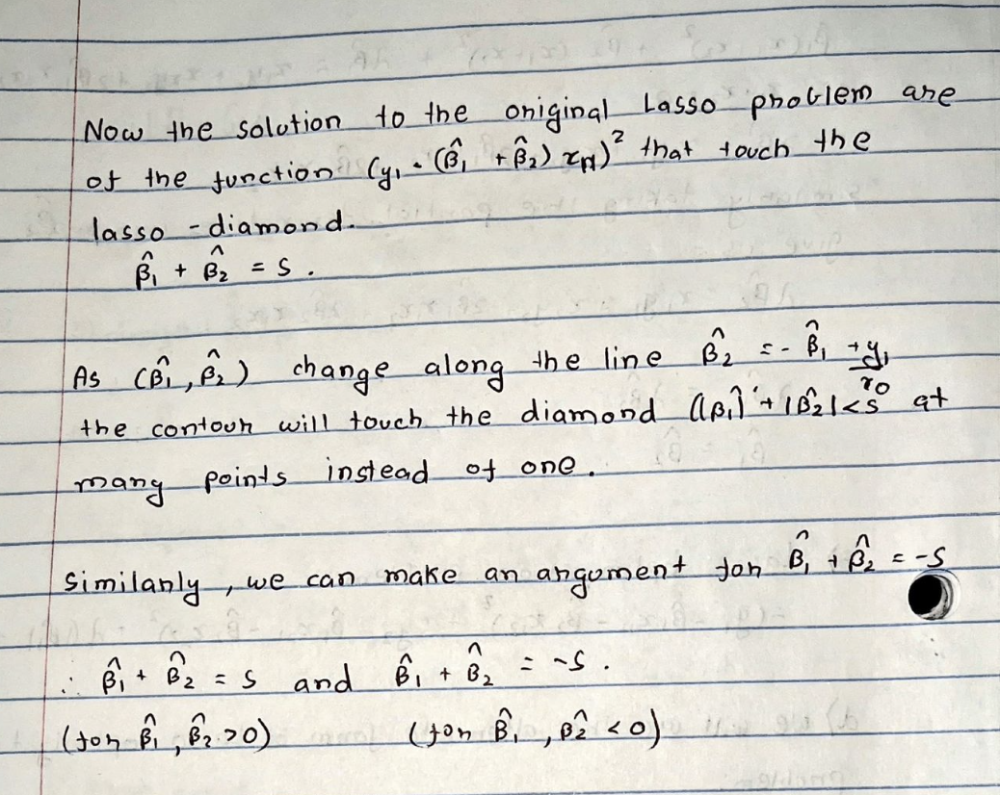

In [55]:
from IPython.display import Image
Image(filename='ISLR6.6.5.3.png')

## ISLR 8.4.5

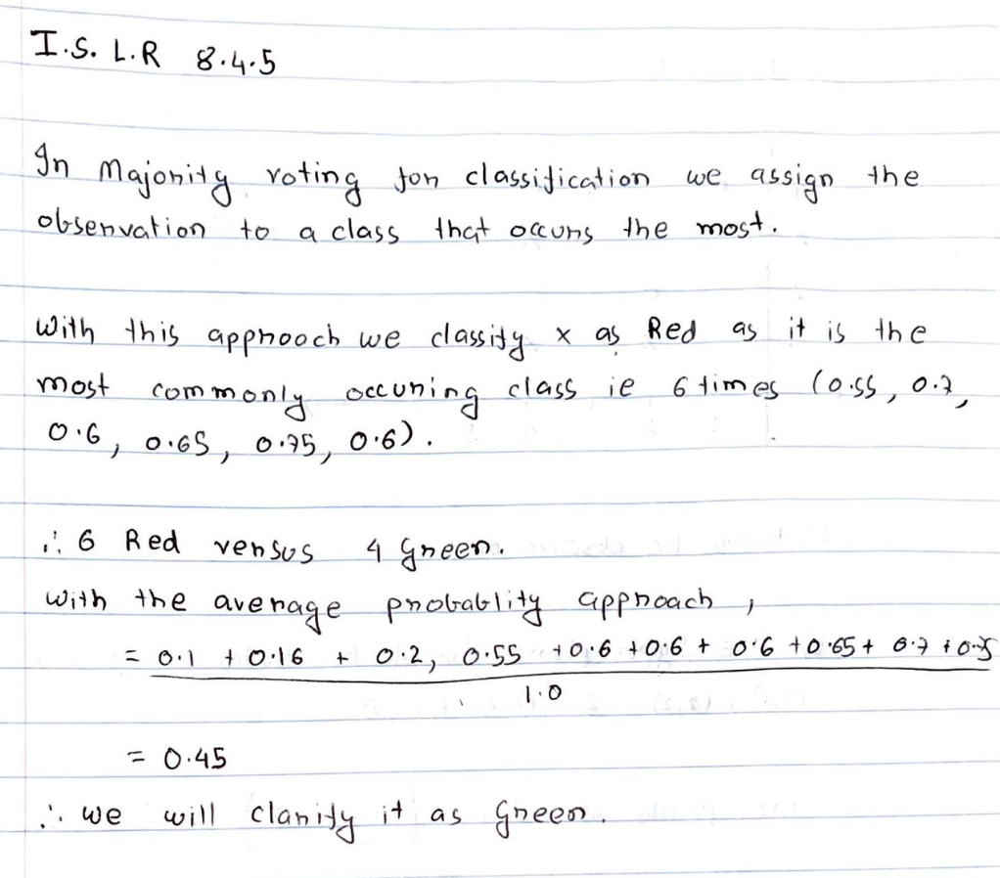

In [56]:
from IPython.display import Image
Image(filename='ISLR8.4.5.png')

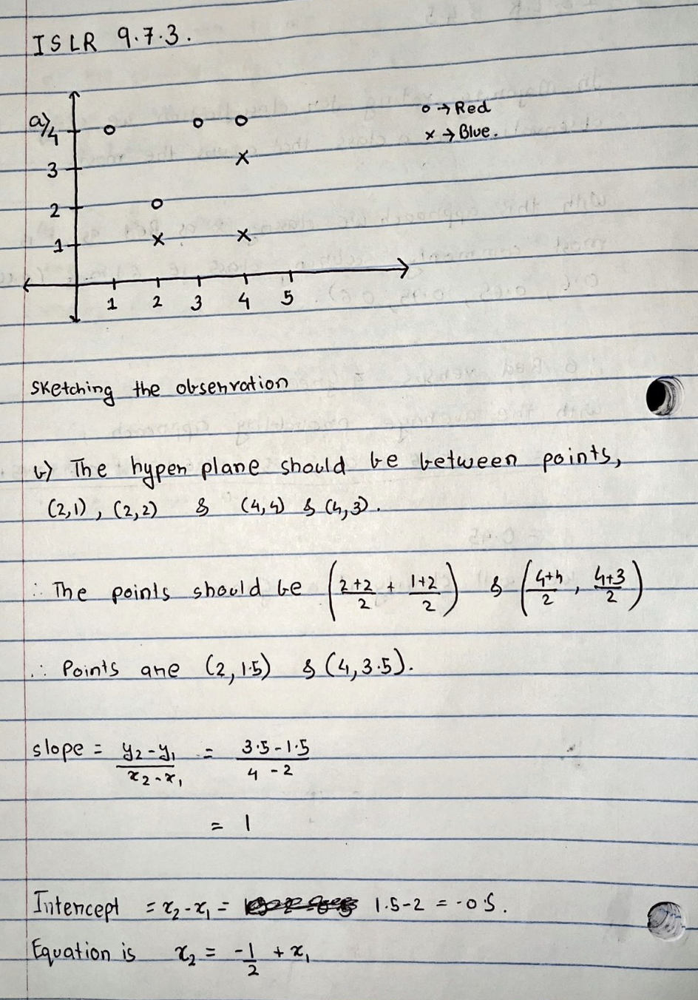

In [57]:
from IPython.display import Image
Image(filename='ISLR9.7.3.png')

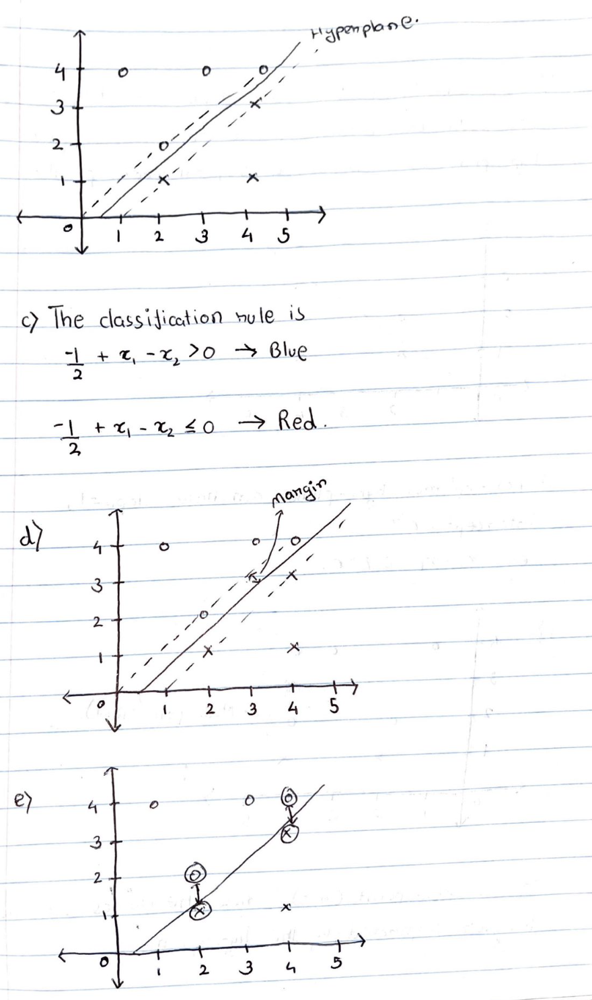

In [59]:
from IPython.display import Image
Image(filename='ISLR9.7.3.2.png')

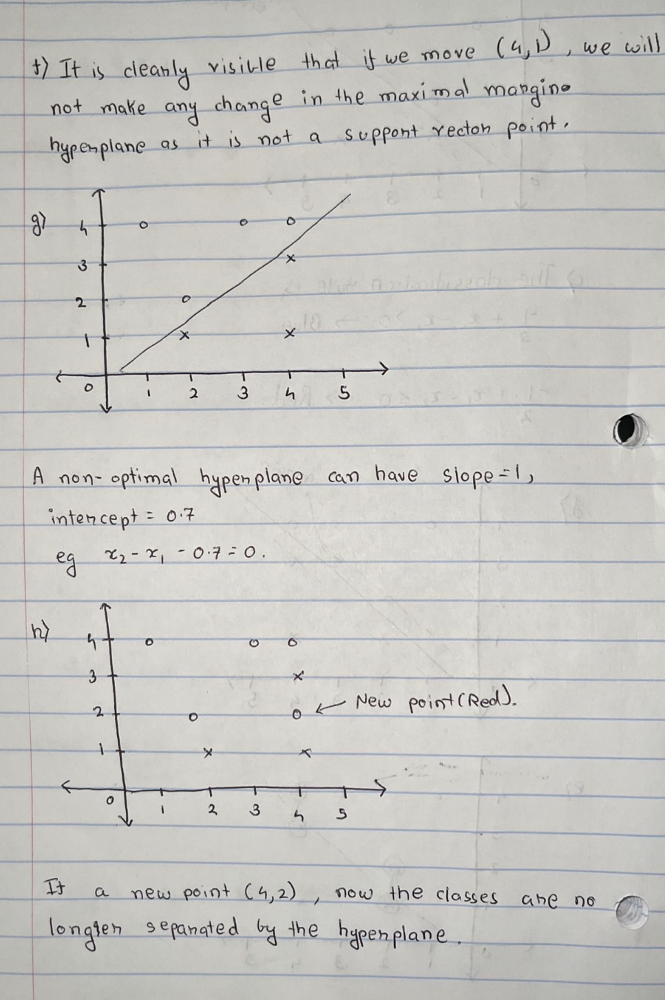

In [60]:
from IPython.display import Image
Image(filename='ISLR9.7.3.3.png')